In [21]:
import pm4py
import pandas as pd
import matplotlib.pyplot as plt
from pm4py.algo.filtering.log.variants import variants_filter

In [22]:
log = pm4py.read_xes("bpi-chall.xes")

parsing log, completed traces :: 100%|██████████| 31509/31509 [00:43<00:00, 722.39it/s] 


In [23]:
if isinstance(log, pd.DataFrame):
    df = log
else:
    df = pm4py.convert_to_dataframe(log)

In [24]:
df.describe()

,case:RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,MonthlyCost,CreditScore,OfferedAmount
count,1.202267e+06,42995.000000,42995.000000,42995.000000,42995.000000,42995.000000
mean,1.675947e+04,8394.338979,83.041982,281.403309,318.645912,18513.719940
std,1.572320e+04,10852.443358,36.386199,192.577735,433.706216,13718.507416
min,0.000000e+00,0.000000,5.000000,43.050000,0.000000,5000.000000
25%,6.000000e+03,0.000000,56.000000,152.820000,0.000000,8800.000000
50%,1.400000e+04,5000.000000,77.000000,244.520000,0.000000,15000.000000
75%,2.300000e+04,12000.000000,120.000000,350.000000,848.000000,25000.000000
max,4.500000e+05,75000.000000,180.000000,6673.830000,1145.000000,75000.000000


In [25]:
df.head(10)

,Action,org:resource,concept:name,EventOrigin,EventID,lifecycle:transition,time:timestamp,case:LoanGoal,case:ApplicationType,case:concept:name,case:RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID
0,Created,User_1,A_Create Application,Application,Application_652823628,complete,2016-01-01 09:51:15.304000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,statechange,User_1,A_Submitted,Application,ApplState_1582051990,complete,2016-01-01 09:51:15.352000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Created,User_1,W_Handle leads,Workflow,Workitem_1298499574,schedule,2016-01-01 09:51:15.774000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Deleted,User_1,W_Handle leads,Workflow,Workitem_1673366067,withdraw,2016-01-01 09:52:36.392000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Created,User_1,W_Complete application,Workflow,Workitem_1493664571,schedule,2016-01-01 09:52:36.403000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,statechange,User_1,A_Concept,Application,ApplState_642383566,complete,2016-01-01 09:52:36.413000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Obtained,User_17,W_Complete application,Workflow,Workitem_1875340971,start,2016-01-02 10:45:22.429000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Released,User_17,W_Complete application,Workflow,Workitem_1452291795,suspend,2016-01-02 10:49:28.816000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,statechange,User_52,A_Accepted,Application,ApplState_99568828,complete,2016-01-02 11:23:04.299000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Created,User_52,O_Create Offer,Offer,Offer_148581083,complete,2016-01-02 11:29:03.994000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,NaN


In [26]:
len(log)

1202267

In [27]:
variants = pm4py.statistics.variants.log.get.get_variants(log)
variants

{('A_Create Application',
  'A_Submitted',
  'W_Handle leads',
  'W_Handle leads',
  'W_Complete application',
  'A_Concept',
  'W_Complete application',
  'W_Complete application',
  'A_Accepted',
  'O_Create Offer',
  'O_Created',
  'O_Sent (mail and online)',
  'W_Complete application',
  'W_Call after offers',
  'W_Call after offers',
  'A_Complete',
  'W_Call after offers',
  'W_Call after offers',
  'W_Call after offers',
  'W_Call after offers',
  'W_Validate application',
  'W_Validate application',
  'A_Validating',
  'O_Returned',
  'W_Validate application',
  'W_Validate application',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'A_Incomplete',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'W_Validate application',
  'W_Validate application',
  'A_Validating',
  'W_Validate application',
  'O_Accepted',
  'A_Pending',
  'W_Validate application'): [{'attributes': {'LoanGoal': 'Existing loan

In [28]:
from pm4py.statistics.variants.log import get as variants_get

variants_dict = variants_get.get_variants(log)

unique_variants = {}
seen_sequences = set()

for variant_key, traces in variants_dict.items():
    sequence = tuple(event["concept:name"] for event in traces[0])
    
    if sequence not in seen_sequences:
        seen_sequences.add(sequence)
        unique_variants[variant_key] = traces

unique_variants


{('A_Create Application',
  'A_Submitted',
  'W_Handle leads',
  'W_Handle leads',
  'W_Complete application',
  'A_Concept',
  'W_Complete application',
  'W_Complete application',
  'A_Accepted',
  'O_Create Offer',
  'O_Created',
  'O_Sent (mail and online)',
  'W_Complete application',
  'W_Call after offers',
  'W_Call after offers',
  'A_Complete',
  'W_Call after offers',
  'W_Call after offers',
  'W_Call after offers',
  'W_Call after offers',
  'W_Validate application',
  'W_Validate application',
  'A_Validating',
  'O_Returned',
  'W_Validate application',
  'W_Validate application',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'A_Incomplete',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'W_Call incomplete files',
  'W_Validate application',
  'W_Validate application',
  'A_Validating',
  'W_Validate application',
  'O_Accepted',
  'A_Pending',
  'W_Validate application'): [{'attributes': {'LoanGoal': 'Existing loan

In [29]:
df = pm4py.convert_to_dataframe(log)

In [30]:
df["time:timestamp"] = pd.to_datetime(df["time:timestamp"])

In [31]:
case_durations = (
    df.groupby("case:concept:name")["time:timestamp"]
    .agg(["min", "max"])
    .assign(duration=lambda x: (x["max"] - x["min"]).dt.total_seconds())
)

avg_duration = case_durations["duration"].mean()
std_duration = case_durations["duration"].std()

In [32]:
avg_duration

1892125.9230699483

In [33]:
std_duration

1137821.690875759

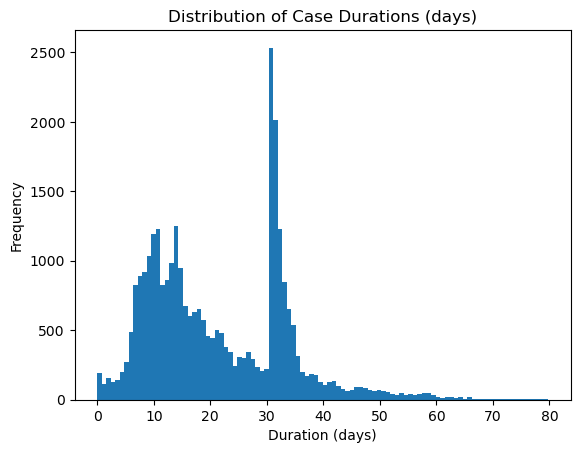

In [ ]:
import matplotlib.pyplot as plt

durations_days = case_durations["duration"] / (60 * 60 * 24)

durations_capped = durations_days[durations_days <= 80]

# Plot histogram
plt.hist(durations_capped, bins=100)
plt.title("Distribution of Case Durations (days)")
plt.xlabel("Duration (days)")
plt.ylabel("Frequency")
plt.show()


In [35]:
num_unique_act_per_var = df.groupby("case:concept:name")["concept:name"].nunique().mean()
num_unique_act_per_var

15.532324097876797

In [37]:
median_case_dur = case_durations["duration"].median()
median_case_dur

1649180.668

                Event Label   Count  Percentage
0    W_Validate application  209496   17.425081
1       W_Call after offers  191092   15.894306
2   W_Call incomplete files  168529   14.017602
3    W_Complete application  148900   12.384936
4            W_Handle leads   47264    3.931240
5            O_Create Offer   42995    3.576161
6                 O_Created   42995    3.576161
7  O_Sent (mail and online)   39707    3.302677
8              A_Validating   38816    3.228567
9      A_Create Application   31509    2.620799


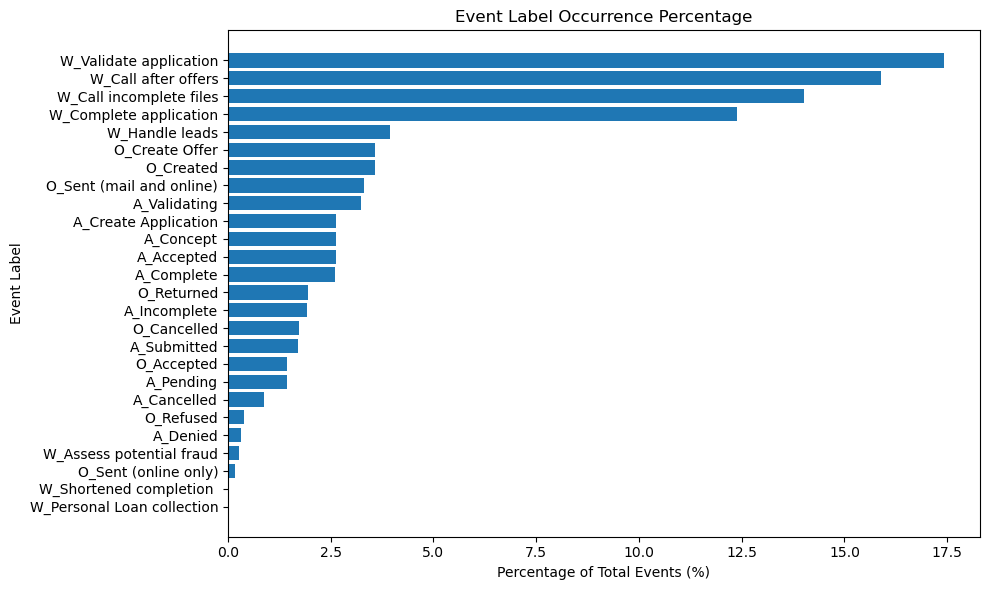

In [ ]:

event_label_counts = df["concept:name"].value_counts()

event_label_percentages = (event_label_counts / event_label_counts.sum()) * 100

event_label_summary = pd.DataFrame({
    "Event Label": event_label_counts.index,
    "Count": event_label_counts.values,
    "Percentage": event_label_percentages.values
})

event_label_summary = event_label_summary.sort_values("Count", ascending=False)

print(event_label_summary.head(10))

plt.figure(figsize=(10, 6))
plt.barh(event_label_summary["Event Label"], event_label_summary["Percentage"])
plt.gca().invert_yaxis()  # largest bar on top
plt.title("Event Label Occurrence Percentage")
plt.xlabel("Percentage of Total Events (%)")
plt.ylabel("Event Label")
plt.tight_layout()
plt.show()


=== Event label stats by category ===
       Category              concept:name  Count  Percentage
9   Application              A_Validating  38816   16.200672
0   Application                A_Accepted  31509   13.150942
3   Application                 A_Concept  31509   13.150942
4   Application      A_Create Application  31509   13.150942
2   Application                A_Complete  31362   13.089589
6   Application              A_Incomplete  23055    9.622488
8   Application               A_Submitted  20423    8.523968
7   Application                 A_Pending  17228    7.190467
1   Application               A_Cancelled  10431    4.353597
5   Application                  A_Denied   3753    1.566393
12        Offer            O_Create Offer  42995   22.179635
13        Offer                 O_Created  42995   22.179635
16        Offer  O_Sent (mail and online)  39707   20.483469
15        Offer                O_Returned  23305   12.022244
11        Offer               O_Cancelled  2089

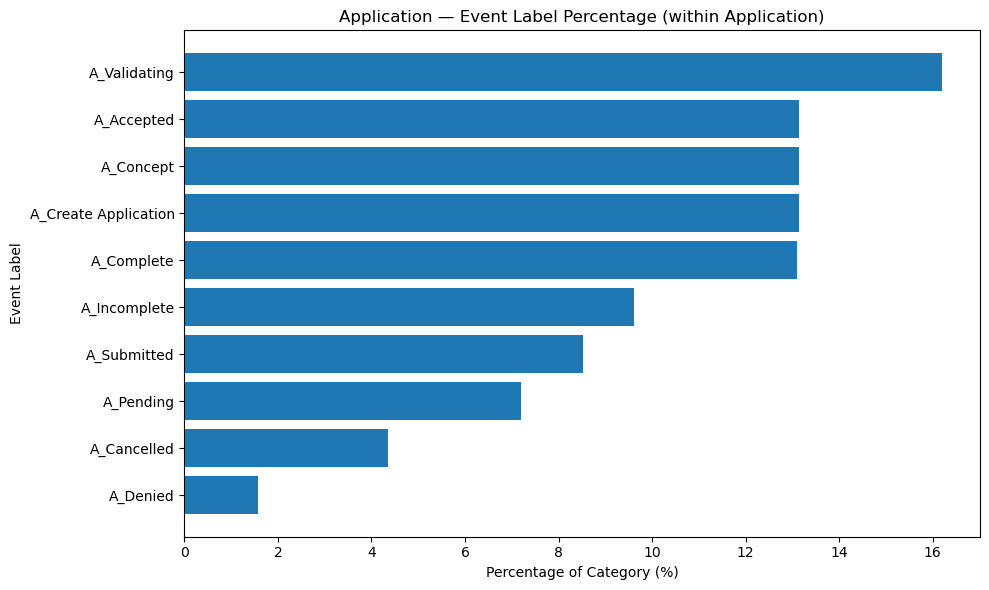

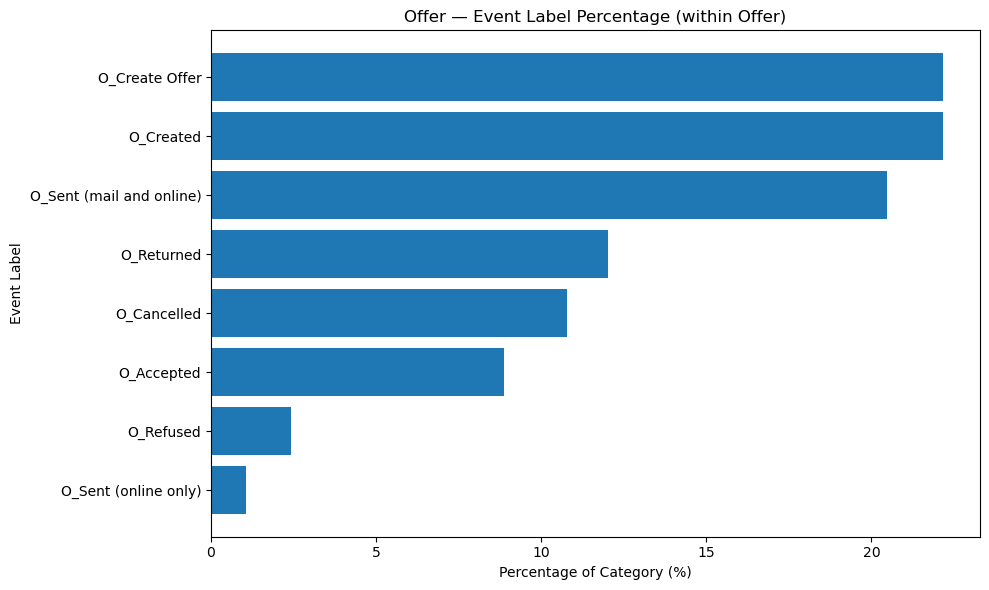

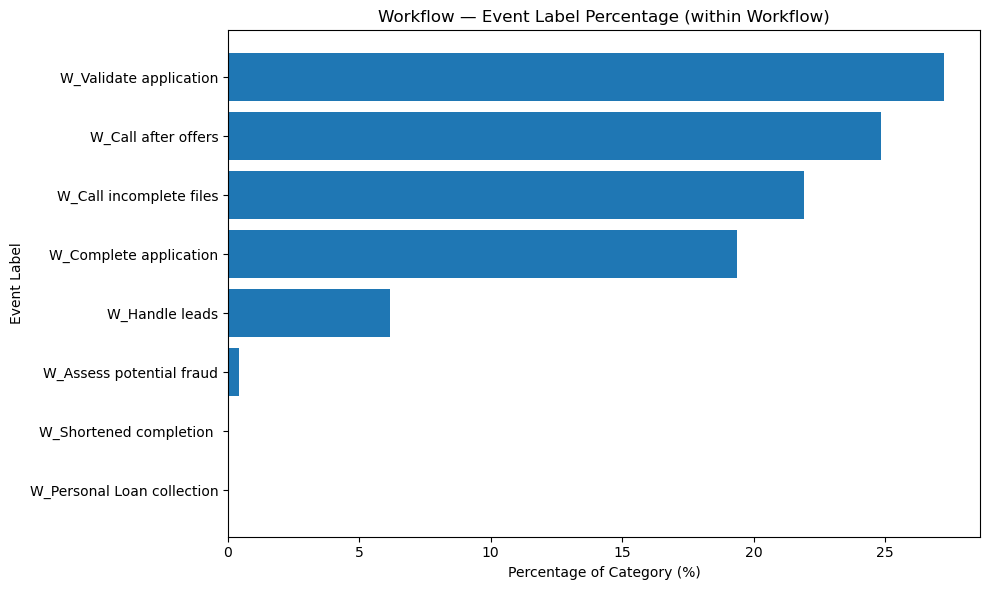


=== Overall share of categories ===
      Category  Percentage
0     Workflow   63.947775
1  Application   19.928602
2        Offer   16.123623

=== Application Category ===
        concept:name  Count  Percentage  Relative Probability
        A_Validating  38816   16.200672              0.162007
          A_Accepted  31509   13.150942              0.131509
           A_Concept  31509   13.150942              0.131509
A_Create Application  31509   13.150942              0.131509
          A_Complete  31362   13.089589              0.130896
        A_Incomplete  23055    9.622488              0.096225
         A_Submitted  20423    8.523968              0.085240
           A_Pending  17228    7.190467              0.071905
         A_Cancelled  10431    4.353597              0.043536
            A_Denied   3753    1.566393              0.015664

=== Offer Category ===
            concept:name  Count  Percentage  Relative Probability
          O_Create Offer  42995   22.179635          

In [ ]:
import re
import matplotlib.pyplot as plt

df_sub = df.copy()
df_sub["Category"] = df_sub["concept:name"].str.extract(r"^([A-Z])_")
df_sub["Category"] = df_sub["Category"].map({"A": "Application", "O": "Offer", "W": "Workflow"})

missing = df_sub["Category"].isna().sum()
if missing:
    print(f"{missing} events without recognized prefix (not A_/O_/W_)")

category_stats = (
    df_sub.groupby(["Category", "concept:name"])
    .size()
    .reset_index(name="Count")
)

category_totals = category_stats.groupby("Category")["Count"].transform("sum")
category_stats["Percentage"] = 100 * category_stats["Count"] / category_totals

category_stats = category_stats.sort_values(["Category", "Count"], ascending=[True, False])

print("=== Event label stats by category ===")
print(category_stats.head(15))

TOP_N = 20
for cat, subset in category_stats.groupby("Category"):
    sub = subset.nlargest(TOP_N, "Count")  # take top N by count within category
    plt.figure(figsize=(10, 6))
    plt.barh(sub["concept:name"], sub["Percentage"])
    plt.gca().invert_yaxis()
    plt.title(f"{cat} — Event Label Percentage (within {cat})")
    plt.xlabel("Percentage of Category (%)")
    plt.ylabel("Event Label")
    plt.tight_layout()
    plt.show()

category_share = (df_sub["Category"].value_counts(normalize=True) * 100).rename("Percentage").reset_index()
category_share = category_share.rename(columns={"index": "Category"})
print("\n=== Overall share of categories ===")
print(category_share)

category_tables = {}

for cat, subset in category_stats.groupby("Category"):
    sub = subset.copy()
    sub["Relative Probability"] = sub["Percentage"] / 100  # convert % → probability
    sub = sub.sort_values("Count", ascending=False).reset_index(drop=True)
    category_tables[cat] = sub[["concept:name", "Count", "Percentage", "Relative Probability"]]

    print(f"\n=== {cat} Category ===")
    print(sub[["concept:name", "Count", "Percentage", "Relative Probability"]].to_string(index=False))


=== Event label stats by category (case-based) ===
       Category              concept:name  CaseCount  CategoryCaseTotal  \
0   Application                A_Accepted      31509              31509   
3   Application                 A_Concept      31509              31509   
4   Application      A_Create Application      31509              31509   
2   Application                A_Complete      31362              31509   
9   Application              A_Validating      21870              31509   
8   Application               A_Submitted      20423              31509   
7   Application                 A_Pending      17228              31509   
6   Application              A_Incomplete      15003              31509   
1   Application               A_Cancelled      10431              31509   
5   Application                  A_Denied       3752              31509   
12        Offer            O_Create Offer      31509              31509   
13        Offer                 O_Created      31

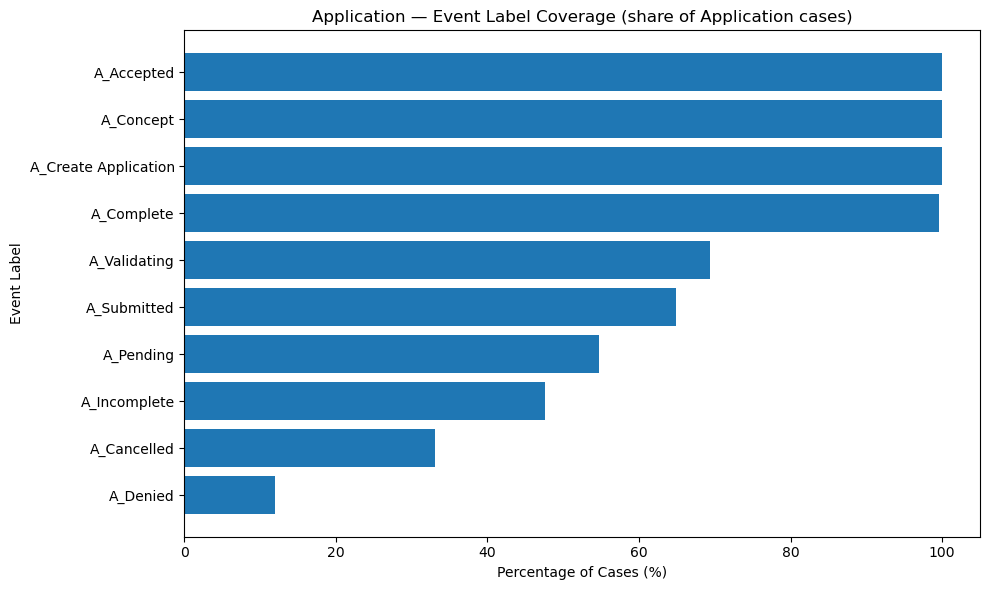

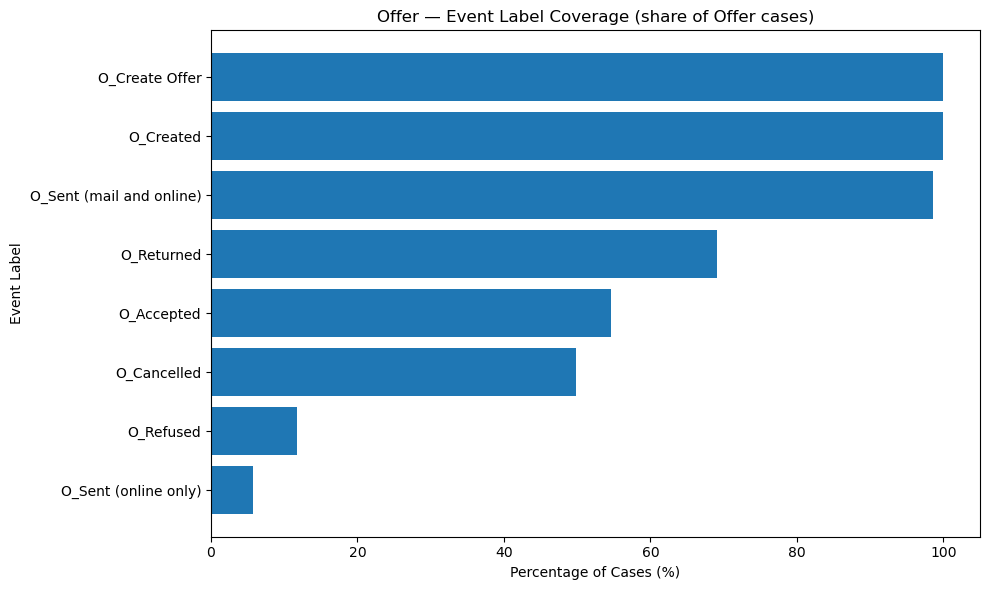

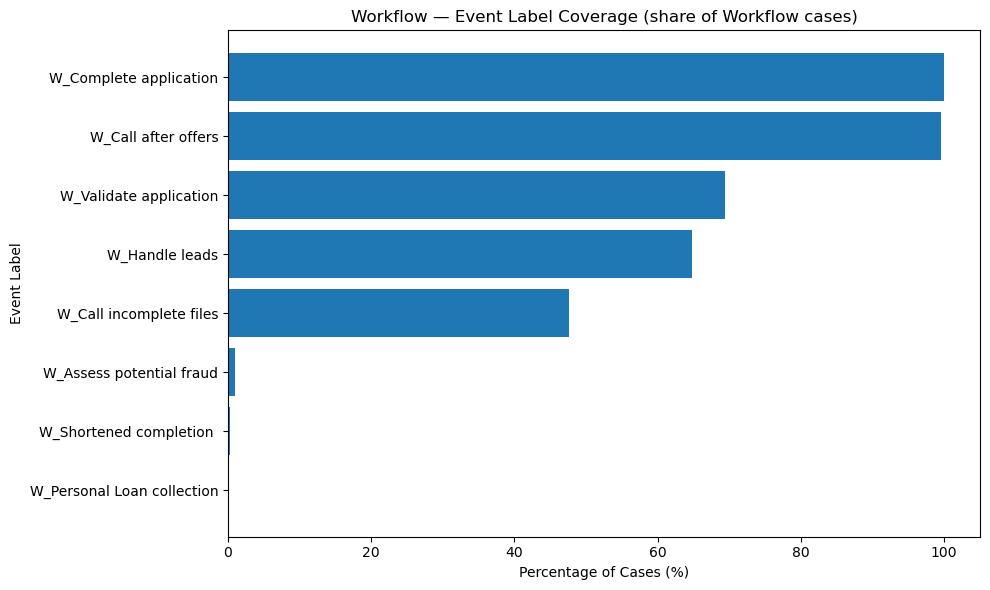


=== Share of cases that contain any events from each category ===
      Category  CaseCount  Percentage_of_all_cases
0  Application      31509                    100.0
1        Offer      31509                    100.0
2     Workflow      31509                    100.0

=== Application Category (case-based) ===
        concept:name  CaseCount  CategoryCaseTotal  Percentage  Relative Probability
          A_Accepted      31509              31509  100.000000              1.000000
           A_Concept      31509              31509  100.000000              1.000000
A_Create Application      31509              31509  100.000000              1.000000
          A_Complete      31362              31509   99.533467              0.995335
        A_Validating      21870              31509   69.408740              0.694087
         A_Submitted      20423              31509   64.816402              0.648164
           A_Pending      17228              31509   54.676442              0.546764
      

In [ ]:
# unique calc of events
import re
import matplotlib.pyplot as plt

df_sub = df.copy()
df_sub["Category"] = df_sub["concept:name"].str.extract(r"^([A-Z])_")
df_sub["Category"] = df_sub["Category"].map({"A": "Application", "O": "Offer", "W": "Workflow"})

missing = df_sub["Category"].isna().sum()
if missing:
    print(f"{missing} events without recognized prefix (not A_/O_/W_)")

CASE_COL = "case:concept:name"

case_event_presence = (
    df_sub.dropna(subset=["Category"])
         .drop_duplicates(subset=[CASE_COL, "Category", "concept:name"])
         .loc[:, [CASE_COL, "Category", "concept:name"]]
)

category_event_case_counts = (
    case_event_presence.groupby(["Category", "concept:name"])[CASE_COL]
    .nunique()
    .reset_index(name="CaseCount")
)

category_case_totals = (
    case_event_presence.groupby("Category")[CASE_COL]
    .nunique()
    .rename("CategoryCaseTotal")
    .reset_index()
)

# Merge and compute percentages (case-based)
category_stats = category_event_case_counts.merge(category_case_totals, on="Category", how="left")
category_stats["Percentage"] = 100 * category_stats["CaseCount"] / category_stats["CategoryCaseTotal"]

category_stats = category_stats.sort_values(["Category", "CaseCount"], ascending=[True, False])

print("=== Event label stats by category (case-based) ===")
print(category_stats.head(15))

TOP_N = 20
for cat, subset in category_stats.groupby("Category"):
    sub = subset.nlargest(TOP_N, "CaseCount")
    plt.figure(figsize=(10, 6))
    plt.barh(sub["concept:name"], sub["Percentage"])
    plt.gca().invert_yaxis()
    plt.title(f"{cat} — Event Label Coverage (share of {cat} cases)")
    plt.xlabel("Percentage of Cases (%)")
    plt.ylabel("Event Label")
    plt.tight_layout()
    plt.show()

case_has_category = (
    case_event_presence.drop_duplicates(subset=[CASE_COL, "Category"])
    .groupby("Category")[CASE_COL].nunique()
    .reset_index(name="CaseCount")
)

total_cases = df_sub[CASE_COL].nunique()
case_has_category["Percentage_of_all_cases"] = 100 * case_has_category["CaseCount"] / total_cases

print("\n=== Share of cases that contain any events from each category ===")
print(case_has_category.sort_values("CaseCount", ascending=False))

category_tables = {}
for cat, subset in category_stats.groupby("Category"):
    sub = subset.copy().sort_values("CaseCount", ascending=False).reset_index(drop=True)
    sub["Relative Probability"] = sub["Percentage"] / 100.0  # share of cases as probability
    category_tables[cat] = sub[["concept:name", "CaseCount", "CategoryCaseTotal", "Percentage", "Relative Probability"]]

    print(f"\n=== {cat} Category (case-based) ===")
    print(sub[["concept:name", "CaseCount", "CategoryCaseTotal", "Percentage", "Relative Probability"]].to_string(index=False))


Text(0.5, 1.0, 'Events by Weekday')

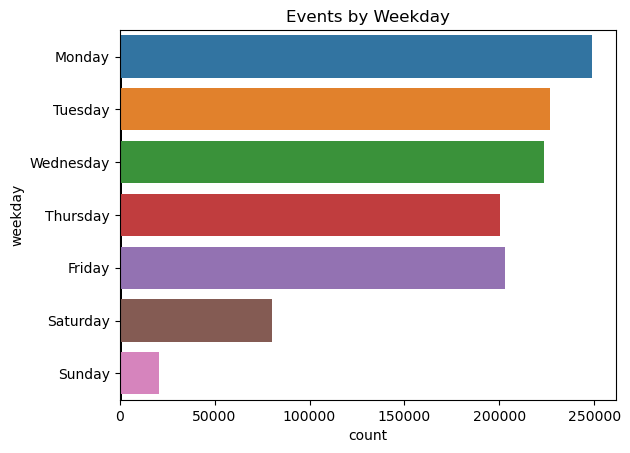

In [51]:
import seaborn as sns
import matplotlib.pyplot as plt

df["hour"] = df["time:timestamp"].dt.hour
sns.histplot(df["hour"], bins=24)
plt.title("Events per Hour of Day")

df["weekday"] = df["time:timestamp"].dt.day_name()
sns.countplot(y="weekday", data=df, order=["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"])
plt.title("Events by Weekday")


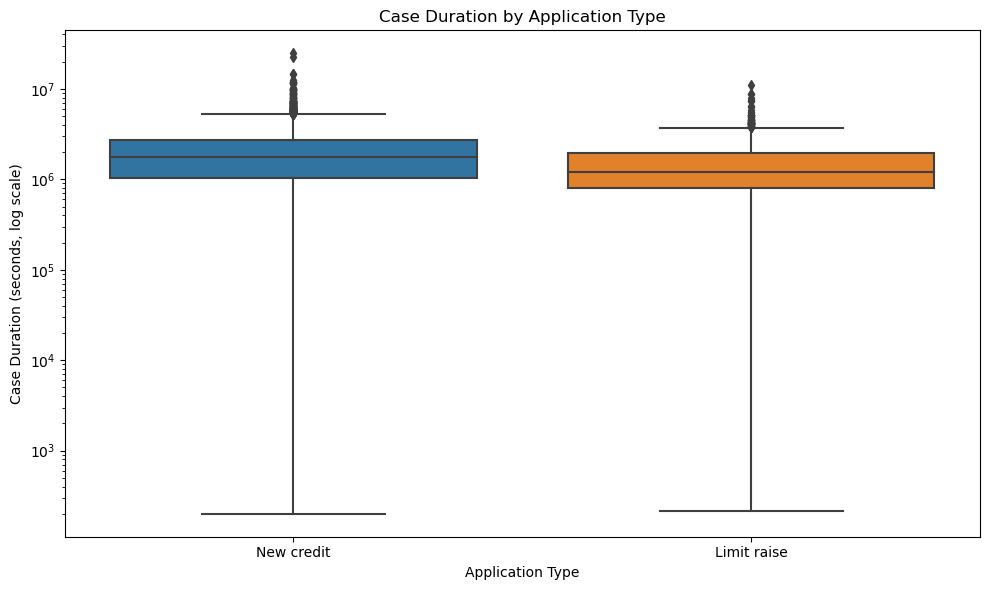

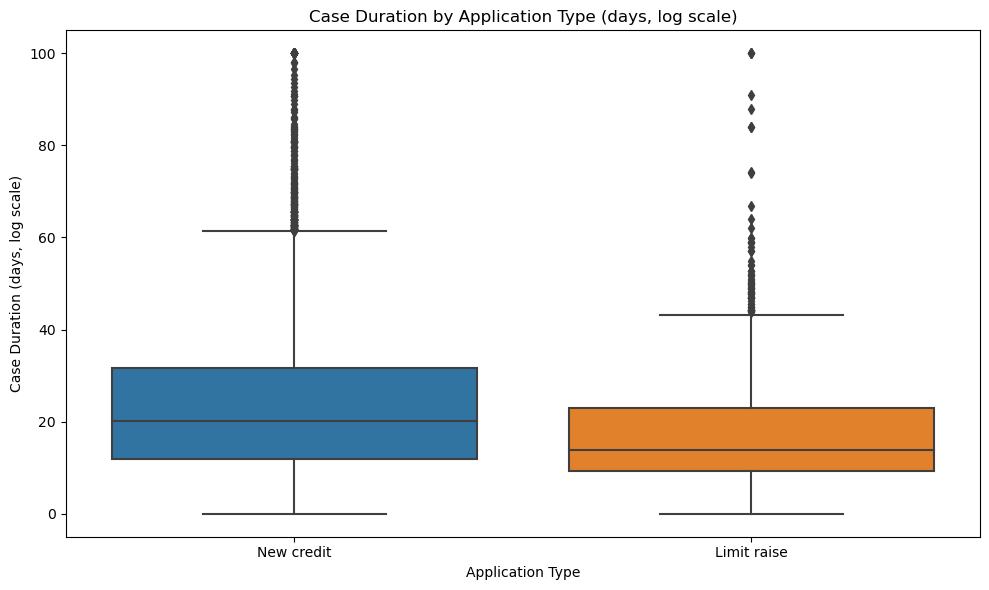

In [70]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

app_col_candidates = [c for c in df.columns if c.lower().endswith("applicationtype")]
if not app_col_candidates:
    raise ValueError("No column matching '*ApplicationType' found. Check your columns in df.columns")

app_col = app_col_candidates[0]

case_types = (
    df[["case:concept:name", app_col]]
    .dropna(subset=[app_col])
    .drop_duplicates(subset=["case:concept:name"], keep="first")
)

case_stats = (
    case_durations.reset_index() # brings case id out of index
    .merge(case_types, on="case:concept:name", how="left")
    .rename(columns={"duration": "duration_sec"})
)

case_stats = case_stats.dropna(subset=[app_col])

plt.figure(figsize=(10, 6))
sns.boxplot(
    data=case_stats,
    x=app_col,
    y="duration_sec"
)
plt.yscale("log")
plt.title("Case Duration by Application Type")
plt.xlabel("Application Type")
plt.ylabel("Case Duration (seconds, log scale)")
plt.tight_layout()
plt.show()

case_stats["duration_days"] = case_stats["duration_sec"] / 86400
case_stats["duration_days"] = case_stats["duration_days"].clip(upper=100)
medians = case_stats.groupby(app_col)["duration_days"].median().sort_values()
plt.figure(figsize=(10, 6))
sns.boxplot(
    data=case_stats,
    x=app_col,
    y="duration_days",
    order=medians.index[::-1]

)
#plt.yscale("log")
plt.title("Case Duration by Application Type (days, log scale)")
plt.xlabel("Application Type")
plt.ylabel("Case Duration (days, log scale)")
plt.tight_layout()
plt.show()


In [54]:
# count appl type
app_counts = case_stats[app_col].value_counts(dropna=False)
app_percent = case_stats[app_col].value_counts(normalize=True, dropna=False) * 100

app_summary = pd.DataFrame({
    'Count': app_counts,
    'Percentage': app_percent.round(2)
})

print(app_summary)

                      Count  Percentage
case:ApplicationType                   
New credit            28120       89.24
Limit raise            3389       10.76


In [59]:
CASE_COL  = "case:concept:name"
EVENT_COL = "concept:name"

presence = (
    df_sub[[CASE_COL, EVENT_COL]]
      .dropna(subset=[CASE_COL, EVENT_COL])
      .drop_duplicates()
)

# case–event matrix
case_event_matrix = pd.crosstab(presence[CASE_COL], presence[EVENT_COL])
case_event_matrix = (case_event_matrix > 0).astype(int) # ensure bin


In [ ]:
def prove_cooccurrence(event_a, event_b):
    a = case_event_matrix[event_a] == 1
    b = case_event_matrix[event_b] == 1

    both = (a & b).sum()
    only_a = (a & ~b).sum()
    only_b = (~a & b).sum()
    neither = (~a & ~b).sum()

    total = len(case_event_matrix)
    p_a = a.sum() / total
    p_b = b.sum() / total
    p_b_given_a = both / a.sum() if a.sum() else np.nan
    p_a_given_b = both / b.sum() if b.sum() else np.nan
    jaccard = both / (a | b).sum() if (a | b).sum() else np.nan

    # bin correlation
    phi = (both * neither - only_a * only_b) / np.sqrt(
        (a.sum() * b.sum() * (~a).sum() * (~b).sum())
    )

    return {
        "Event A": event_a,
        "Event B": event_b,
        "P(A)": p_a,
        "P(B)": p_b,
        "P(B|A)": p_b_given_a,
        "P(A|B)": p_a_given_b,
        "Jaccard": jaccard,
        "Phi": phi,
        "Both": both,
        "Only A": only_a,
        "Only B": only_b,
        "Total": total,
    }


In [62]:
pairs = [
    ("A_Complete", "W_Call after offers"),
    ("A_Validating", "W_Validate application"),
    ("A_Submitted", "W_Handle leads"),
    ("A_Incomplete", "W_Call incomplete files"),
    ("A_Pending", "O_Accepted"),
    ("A_Cancelled", "O_Cancelled"),
    ("A_Denied", "O_Refused")
]

results = pd.DataFrame([prove_cooccurrence(a, b) for a, b in pairs])
print(results[["Event A", "Event B", "P(A)", "P(B)", "P(B|A)", "P(A|B)", "Jaccard", "Phi"]])


        Event A                  Event B      P(A)      P(B)    P(B|A)  \
0    A_Complete      W_Call after offers  0.995335  0.995335  1.000000   
1  A_Validating   W_Validate application  0.694087  0.694087  1.000000   
2   A_Submitted           W_Handle leads  0.648164  0.648164  1.000000   
3  A_Incomplete  W_Call incomplete files  0.476150  0.476150  1.000000   
4     A_Pending               O_Accepted  0.546764  0.546764  1.000000   
5   A_Cancelled              O_Cancelled  0.331048  0.497699  1.000000   
6      A_Denied                O_Refused  0.119077  0.118062  0.991471   

     P(A|B)   Jaccard       Phi  
0  1.000000  1.000000  1.000000  
1  1.000000  1.000000  1.000000  
2  1.000000  1.000000  1.000000  
3  1.000000  1.000000  1.000000  
4  1.000000  1.000000  1.000000  
5  0.665158  0.665158  0.706719  
6  1.000000  0.991471  0.995153  
